## Laboratorium 7


## Detekcja obiektów za pomocą Faster-RCNN

### Wprowadzenie

Celem tej listy jest praktyczne zapoznanie się z działaniem dwuetapowych modeli do detekcji obiektów na przykładzie Faster R-CNN. Skorzystamy z gotowej implementacji modelu z pakietu [`torchvision`](https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py). Jeżeli masz inny ulubiony model działający na podobnej zasadzie, możesz z niego skorzystać zamiast podanego. Podobnie implementacja - jeśli masz swoją ulubioną bibliotekę np. Detectron2, MMDetection, możesz z niej skorzystać.

W zadaniu wykorzystany zostanie zbiór danych [_Chess Pieces Dataset_](https://public.roboflow.com/object-detection/chess-full) (autorstwa Roboflow, domena publiczna), ZIP z obrazami i anotacjami powinien być dołączony do instrukcji.

Podczas realizacji tej listy większy nacisk położony zostanie na inferencję z użyciem Faster R-CNN niż na uczenie (które przeprowadzisz raz\*). Kluczowe komponenty w tej architekturze (RPN i RoIHeads) można konfigurować bez ponownego uczenia, dlatego badania skupią się na ich strojeniu. Aby zrozumieć działanie modelu, konieczne będzie spojrzenie w jego głąb, włącznie z częściowym wykonaniem. W tym celu warto mieć na podorędziu kod źródłowy, w szczególności implementacje następujących klas (uwaga - linki do najnowszej implementacji; upewnij się więc, że czytasz kod używanej przez siebie wersji biblioteki):
* `FasterRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py
* `GeneralizedRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/generalized_rcnn.py
* `RegionProposalNetwork`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/rpn.py
* `RoIHeads`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/roi_heads.py

Dogłębne zrozumienie procedury uczenia modelu nie będzie wymagane, niemniej należy mieć ogólną świadomość jak ten proces przebiega i jakie funkcje kosztu są wykorzystywane. Użyjemy gotowej implementacji z submodułu [`references.detection`](https://github.com/pytorch/vision/blob/main/references/detection/train.py) w nieco uproszczonej wersji. Ponieważ ten moduł **nie** jest domyślnie instalowaną częścią pakietu `torchvision`, do instrukcji dołączono jego kod w nieznacznie zmodyfikowanej wersji (`references_detection.zip`).
Jeśli ciekawią Cię szczegóły procesu uczenia, zachęcam do lektury [artykułu](https://arxiv.org/abs/1506.01497) i analizy kodu implementacji.

In [ ]:
# !pip install torchvision>=0.13


[notice] A new release of pip is available: 23.2.1 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/Studia/MGR/CV

/content/drive/MyDrive/Studia/MGR/CV


In [ ]:
!pwd

/content/drive/MyDrive/Studia/MGR/CV


In [ ]:
!pip install opencv-python>=4.0
!pip install torchvision>=0.13
!pip install torch
!pip install scikit-image
!pip install matplotlib
!pip install jupyter

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 103.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.2/117.2 kB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.1/69.1 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.6/383.6 kB 32.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.5/133.5 kB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.7/59.7 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 76.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 6.6 MB/s eta 0:00:00
  Attempting uninstall: jupyter-client
    Found existing installation: jupyter-client 6.1.12
    Uninstalling jupyter-client-6.1.12:
      Successfully uninstalled jupyter-client-6.1.12
  Attempting uninstall: ipykernel
    Found existing installation: ipykernel 5.5.6
    Uninstalling ipykernel-5.5.6:
      Successfully uninstalled ipykernel-5.5.6
  Attempting un

In [ ]:
!pip install pycocotools

### Zadanie 0: Uczenie

Krokiem "zerowym" będzie przygotowanie wstępnie nauczonego modelu i douczenie go na docelowym zbiorze.
Podany zestaw hiperparametrów powinien dawać przyzwoite (niekoniecznie idealne) wyniki - jeśli chcesz, śmiało dobierz swoje własne; nie spędzaj na tym jednak zbyt wiele czasu.

Twoim zadaniem jest nie tylko przeklikanie poniższych komórek, ale przynajmniej ogólne zrozumienie procesu uczenia (przejrzyj implementację `train_one_epoch`) i struktury modelu.

In [ ]:
import os
import time
import datetime

import torch
import torch.utils.data
import torchvision
import torchvision.models.detection as M
from torchvision.io.image import read_image
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image

from detection import coco_utils, presets, utils, transforms
from detection.engine import train_one_epoch, evaluate

In [ ]:
def get_dataset(img_root:str, file_name:str, train:bool=True):
  """Reimplementacja analogicznej funkcji z pakietu references, rozwiązująca drobną niekompatybilność w zbiorze CPD"""
  def fake_segmentation(image, target):
    for obj in target['annotations']:
      x, y, w, h = obj['bbox']
      segm = [x, y, x+w, y, x+w, y+h, x, y+h]
      obj['segmentation'] = [segm]
    return image, target

  tfs = transforms.Compose([
    fake_segmentation,
    coco_utils.ConvertCocoPolysToMask(),
    presets.DetectionPresetTrain(data_augmentation='hflip') if train else presets.DetectionPresetEval(),
    # jeśli chcesz dodać swoje własne augmentacje, możesz zrobić to tutaj
  ])
  ds = coco_utils.CocoDetection(img_root, file_name, transforms=tfs)
  return ds

In [ ]:
# Konfiguracja hiperparametrów
LR = 0.001 # powinno być dobrze dla 1 GPU
WDECAY = 0.0001
EPOCHS = 25
VAL_FREQ = 5 # walidacja i checkpointowanie co N epok
BATCH_SIZE = 2 # dobierz pod możliwości sprzętowe
NUM_WORKERS = 8 # j/w
NUM_CLASSES = 14
DEVICE = 'cuda:0'
DATASET_ROOT = 'dane/chess/'
OUTPUT_DIR = 'dane/outputs/'

In [ ]:
# Zaczytanie datasetów
chess_train = get_dataset(os.path.join(DATASET_ROOT, 'train'), os.path.join(DATASET_ROOT, 'train/_annotations.coco.json'))
chess_val = get_dataset(os.path.join(DATASET_ROOT, 'valid'), os.path.join(DATASET_ROOT, 'valid/_annotations.coco.json'))

loading annotations into memory...
Done (t=2.22s)
creating index...
index created!
loading annotations into memory...
Done (t=0.97s)
creating index...
index created!


In [ ]:
# samplery i loadery
train_sampler = torch.utils.data.RandomSampler(chess_train)
train_batch_sampler = torch.utils.data.BatchSampler(train_sampler, BATCH_SIZE, drop_last=True)
train_loader = torch.utils.data.DataLoader(
  chess_train, batch_sampler=train_batch_sampler, num_workers=NUM_WORKERS, collate_fn=utils.collate_fn
)

val_sampler = torch.utils.data.SequentialSampler(chess_val)
val_loader = torch.utils.data.DataLoader(
  chess_val, batch_size=1, sampler=val_sampler, num_workers=NUM_WORKERS, collate_fn=utils.collate_fn
)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


In [ ]:
# Skonstruowanie modelu; tworzymy w wersji dla 91 klas aby zainicjować wagi wstępnie nauczone na COCO...
model = M.fasterrcnn_resnet50_fpn(weights=M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1, num_classes=91).to(DEVICE)
# ...po czym zastępujemy predyktor mniejszym, dostosowanym do naszego zbioru:
model.roi_heads.box_predictor = M.faster_rcnn.FastRCNNPredictor(in_channels=1024, num_classes=NUM_CLASSES).to(DEVICE)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 103MB/s]


In [ ]:
model # zwróć uwagę na strukturę Box Predictora (dlaczego tyle out_features?)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [ ]:
# Zanim przejdziemy do uczenia pełnego modelu, wykonamy krótkie wstępne uczenie losowo zainicjowanego predyktora:
train_one_epoch(
  model=model,
  optimizer=torch.optim.AdamW(model.roi_heads.box_predictor.parameters(), lr=LR, weight_decay=WDECAY),
  data_loader=train_loader,
  device=DEVICE,
  epoch=0, print_freq=20, scaler=None
)

/content/drive/MyDrive/Studia/MGR/CV/detection/engine.py:30: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=scaler is not None):


Epoch: [0]  [  0/101]  eta: 0:24:08  lr: 0.000011  loss: 4.4325 (4.4325)  loss_classifier: 2.9695 (2.9695)  loss_box_reg: 0.8006 (0.8006)  loss_objectness: 0.6060 (0.6060)  loss_rpn_box_reg: 0.0563 (0.0563)  time: 14.3453  data: 8.5006  max mem: 2534
Epoch: [0]  [ 20/101]  eta: 0:01:47  lr: 0.000211  loss: 3.4832 (3.6869)  loss_classifier: 2.6350 (2.6257)  loss_box_reg: 0.4705 (0.5622)  loss_objectness: 0.4293 (0.4603)  loss_rpn_box_reg: 0.0410 (0.0387)  time: 0.6751  data: 0.0855  max mem: 2681
Epoch: [0]  [ 40/101]  eta: 0:01:03  lr: 0.000411  loss: 1.3653 (2.6568)  loss_classifier: 0.7944 (1.8130)  loss_box_reg: 0.3509 (0.4413)  loss_objectness: 0.1187 (0.3727)  loss_rpn_box_reg: 0.0122 (0.0298)  time: 0.7533  data: 0.1110  max mem: 2681
Epoch: [0]  [ 60/101]  eta: 0:00:38  lr: 0.000610  loss: 1.2668 (2.2170)  loss_classifier: 0.5492 (1.4036)  loss_box_reg: 0.3108 (0.4007)  loss_objectness: 0.3365 (0.3832)  loss_rpn_box_reg: 0.0233 (0.0294)  time: 0.7009  data: 0.0911  max mem: 2681

In [ ]:
# Uczenie pełnego modelu
optimizer = torch.optim.AdamW(
  [p for p in model.parameters() if p.requires_grad],
  lr=LR,
  weight_decay=WDECAY
)
lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[10], gamma=0.1) # dobierz wartości jeśli trzeba

start_time = time.time()
for epoch in range(EPOCHS):
    train_one_epoch(model, optimizer, train_loader, DEVICE, epoch, 20, None)
    lr_scheduler.step()

    # eval and checkpoint every VAL_FREQ epochs
    if (epoch+1) % VAL_FREQ == 0:
      checkpoint = {
          "model": model.state_dict(),
          "optimizer": optimizer.state_dict(),
          "lr_scheduler": lr_scheduler.state_dict(),
          "epoch": epoch,
      }
      utils.save_on_master(checkpoint, os.path.join(OUTPUT_DIR, f"model_{epoch}.pth"))
      utils.save_on_master(checkpoint, os.path.join(OUTPUT_DIR, "checkpoint.pth"))
      evaluate(model, val_loader, device=DEVICE)

total_time = time.time() - start_time
total_time_str = str(datetime.timedelta(seconds=int(total_time)))
print(f"Training time {total_time_str}")

Epoch: [0]  [  0/101]  eta: 0:10:55  lr: 0.000011  loss: 0.3786 (0.3786)  loss_classifier: 0.1115 (0.1115)  loss_box_reg: 0.2545 (0.2545)  loss_objectness: 0.0002 (0.0002)  loss_rpn_box_reg: 0.0125 (0.0125)  time: 6.4920  data: 5.6055  max mem: 3215
Epoch: [0]  [ 20/101]  eta: 0:01:25  lr: 0.000211  loss: 0.2234 (0.2437)  loss_classifier: 0.0749 (0.0814)  loss_box_reg: 0.1334 (0.1512)  loss_objectness: 0.0001 (0.0020)  loss_rpn_box_reg: 0.0075 (0.0091)  time: 0.7891  data: 0.1074  max mem: 3502
Epoch: [0]  [ 40/101]  eta: 0:00:55  lr: 0.000411  loss: 0.2383 (0.2404)  loss_classifier: 0.0697 (0.0809)  loss_box_reg: 0.1391 (0.1482)  loss_objectness: 0.0001 (0.0014)  loss_rpn_box_reg: 0.0083 (0.0100)  time: 0.7395  data: 0.0854  max mem: 3508
Epoch: [0]  [ 60/101]  eta: 0:00:35  lr: 0.000610  loss: 0.2457 (0.2469)  loss_classifier: 0.0739 (0.0821)  loss_box_reg: 0.1534 (0.1521)  loss_objectness: 0.0001 (0.0017)  loss_rpn_box_reg: 0.0102 (0.0110)  time: 0.7679  data: 0.0983  max mem: 3529


In [ ]:
# Inferencja na zadanym obrazie
preprocess = M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1.transforms() # to wystarczy pobrać raz
img = read_image(os.path.join(DATASET_ROOT, 'test/IMG_0159_JPG.rf.1cf4f243b5072d63e492711720df35f7.jpg'))
batch = [preprocess(img).to(DEVICE)]
prediction = model(batch)[0]
# Rysowanie predykcji - wygodny gotowiec
box = draw_bounding_boxes(
  img,
  boxes=prediction['boxes'],
  labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
  colors='red',
  width=4,
)
to_pil_image(box.detach()).show()

In [ ]:
image = to_pil_image(box.detach())

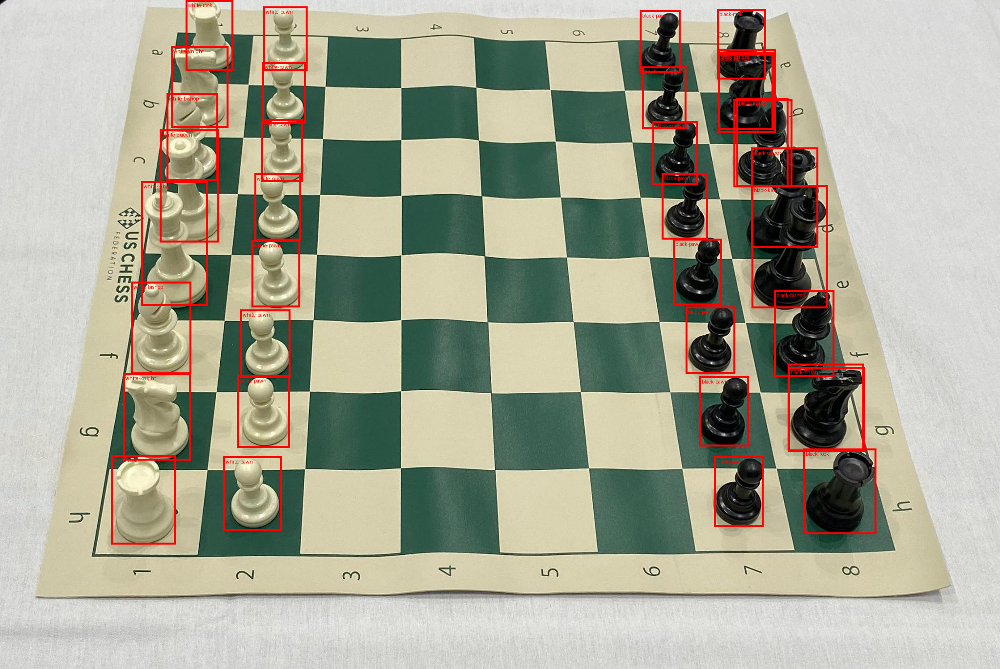

In [ ]:
display(image)

---
### Zadanie 1

Zbadaj wpływ parametrów inferencji **głowic `RoIHeads`**, progu prawdopodobieństwa (`score_thresh`) i progu NMS (`nms_thresh`), na działanie modelu. Wykorzystaj funkcję `evaluate` aby zmierzyć zmianę jakości predykcji, ale przebadaj też efekty wizualnie, wyświetlając predykcje dla kilku obrazów ze zbioru walidacyjnego i kilku spoza zbioru (folder `wild`). _W finalnej wersji pozostaw tylko wybrane interesujące przykłady._

In [ ]:
model.roi_heads

RoIHeads(
  (box_roi_pool): MultiScaleRoIAlign(featmap_names=['0', '1', '2', '3'], output_size=(7, 7), sampling_ratio=2)
  (box_head): TwoMLPHead(
    (fc6): Linear(in_features=12544, out_features=1024, bias=True)
    (fc7): Linear(in_features=1024, out_features=1024, bias=True)
  )
  (box_predictor): FastRCNNPredictor(
    (cls_score): Linear(in_features=1024, out_features=14, bias=True)
    (bbox_pred): Linear(in_features=1024, out_features=56, bias=True)
  )
)

In [ ]:
img_test1 = 'test/IMG_0159_JPG.rf.1cf4f243b5072d63e492711720df35f7.jpg'
img_test2 = 'test/685b860d412b91f5d4f7f9e643b84452_jpg.rf.5ba8dc0b5d2585d01b28089debd42cd6.jpg'
img_test3 = 'test/e4583d082076b2b549b3736ad1b193c9_jpg.rf.be7ed36bb2bee36cf4edad46fdd4ec75.jpg'
img_wild1 = 'wild/chesscom_fide.jpeg'
img_wild2 = 'wild/chesscom_uscf.jpeg'
img_wild3 = 'wild/shop.jpg'

In [ ]:
labels = ['Test1', 'Test2', 'Test3', 'Wild1', 'Wild2', 'Wild3']
images = [img_test1, img_test2, img_test3, img_wild1, img_wild2, img_wild3]

#### Original

In [ ]:
print(model.roi_heads.score_thresh)
print(model.roi_heads.nms_thresh )

0.05
0.5


In [ ]:
evaluate(model, val_loader, device=DEVICE)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Test:  [ 0/58]  eta: 0:02:20  model_time: 0.1916 (0.1916)  evaluator_time: 0.0154 (0.0154)  time: 2.4251  data: 2.1981  max mem: 3533
Test:  [57/58]  eta: 0:00:00  model_time: 0.1121 (0.1288)  evaluator_time: 0.0016 (0.0077)  time: 0.1919  data: 0.0348  max mem: 3533
Test: Total time: 0:00:14 (0.2540 s / it)
Averaged stats: model_time: 0.1121 (0.1288)  evaluator_time: 0.0016 (0.0077)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.297
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.400
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.371
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.297
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

In [ ]:
import matplotlib.pyplot as plt

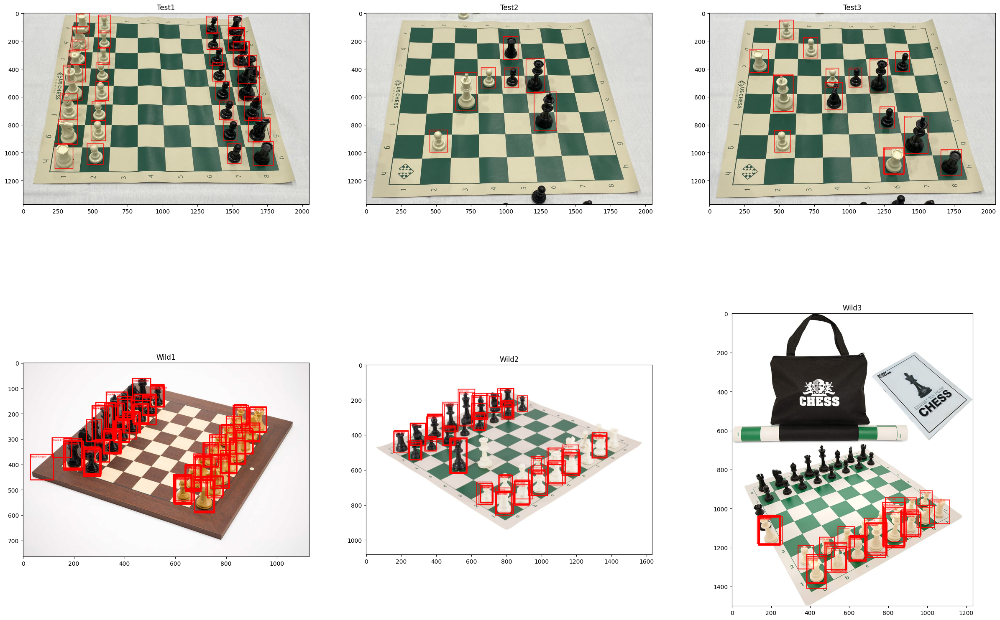

In [ ]:
plt.figure(figsize=[30,20])
for i, img in enumerate(images):
  plt.subplot(2,3,i+1)
  img = read_image(os.path.join(DATASET_ROOT, img))
  batch = [preprocess(img).to(DEVICE)]
  prediction = model(batch)[0]
  # Rysowanie predykcji - wygodny gotowiec
  box = draw_bounding_boxes(
    img,
    boxes=prediction['boxes'],
    labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
    colors='red',
    width=4,
  )
  img = to_pil_image(box.detach()).convert('RGB')
  plt.imshow(img)
  plt.title(labels[i])

#### Change no.1
Zwiększenie nms_thres

In [ ]:
model.roi_heads.score_thresh = 0.05
model.roi_heads.nms_thresh = 0.7

In [ ]:
evaluate(model, val_loader, device=DEVICE)

Test:  [ 0/58]  eta: 0:02:18  model_time: 0.2273 (0.2273)  evaluator_time: 0.0223 (0.0223)  time: 2.3804  data: 2.1050  max mem: 3533
Test:  [57/58]  eta: 0:00:00  model_time: 0.1159 (0.1430)  evaluator_time: 0.0016 (0.0094)  time: 0.1764  data: 0.0226  max mem: 3533
Test: Total time: 0:00:16 (0.2774 s / it)
Averaged stats: model_time: 0.1159 (0.1430)  evaluator_time: 0.0016 (0.0094)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.164
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.227
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.191
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

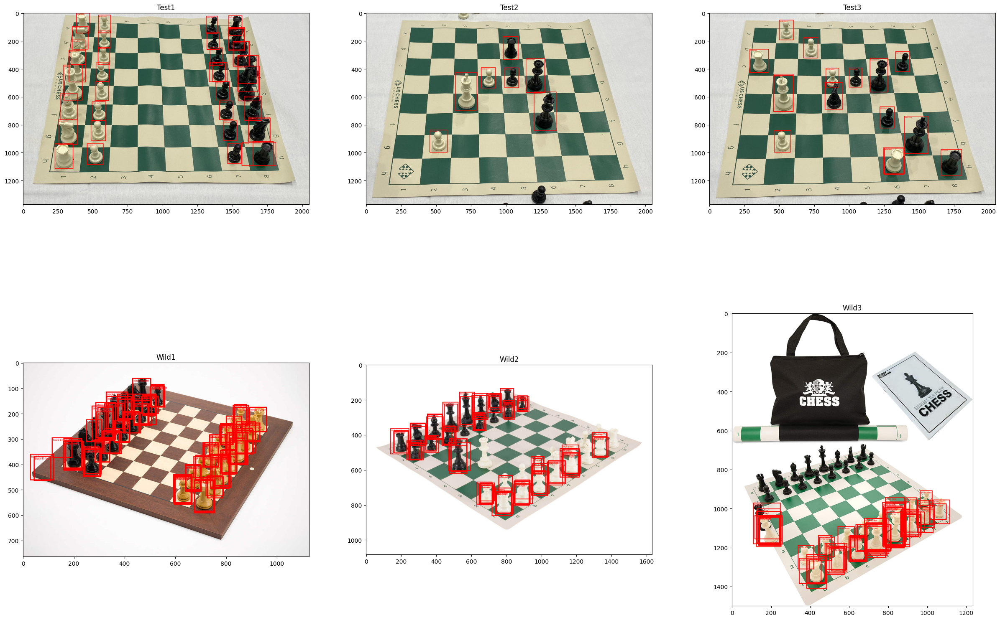

In [ ]:
plt.figure(figsize=[30,20])
for i, img in enumerate(images):
  plt.subplot(2,3,i+1)
  img = read_image(os.path.join(DATASET_ROOT, img))
  batch = [preprocess(img).to(DEVICE)]
  prediction = model(batch)[0]
  # Rysowanie predykcji - wygodny gotowiec
  box = draw_bounding_boxes(
    img,
    boxes=prediction['boxes'],
    labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
    colors='red',
    width=4,
  )
  img = to_pil_image(box.detach()).convert('RGB')
  plt.imshow(img)
  plt.title(labels[i])

#### Change no.2
Zwiększenie score_thres

In [ ]:
model.roi_heads.score_thresh = 0.20
model.roi_heads.nms_thresh = 0.5

In [ ]:
evaluate(model, val_loader, device=DEVICE)

Test:  [ 0/58]  eta: 0:03:45  model_time: 0.2943 (0.2943)  evaluator_time: 0.0231 (0.0231)  time: 3.8802  data: 3.5343  max mem: 3533
Test:  [57/58]  eta: 0:00:00  model_time: 0.1148 (0.1311)  evaluator_time: 0.0014 (0.0060)  time: 0.1510  data: 0.0148  max mem: 3533
Test: Total time: 0:00:15 (0.2596 s / it)
Averaged stats: model_time: 0.1148 (0.1311)  evaluator_time: 0.0014 (0.0060)
Accumulating evaluation results...
DONE (t=0.04s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.125
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.169
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.125
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

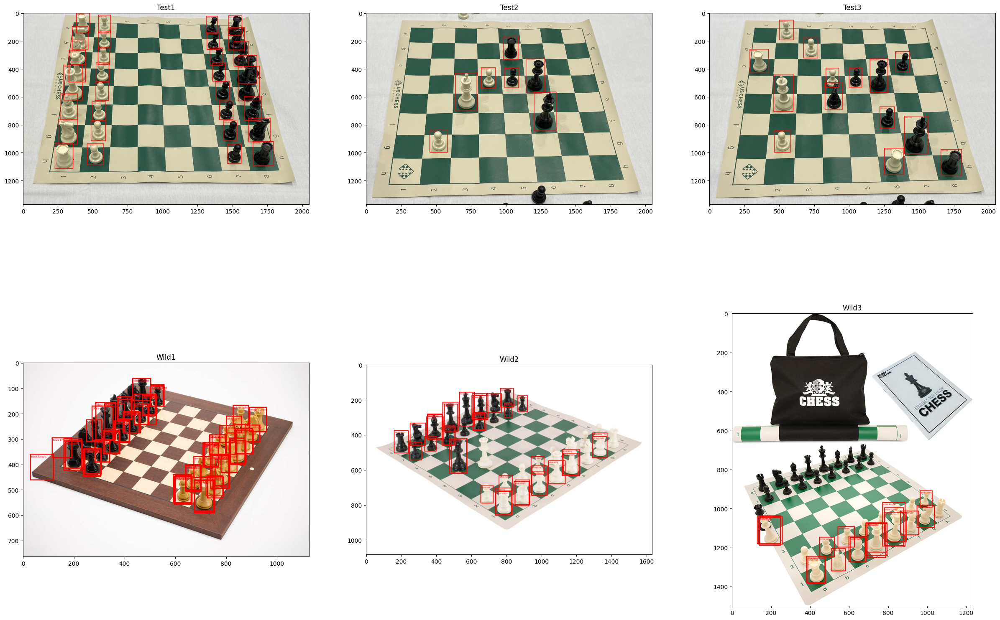

In [ ]:
plt.figure(figsize=[30,20])
for i, img in enumerate(images):
  plt.subplot(2,3,i+1)
  img = read_image(os.path.join(DATASET_ROOT, img))
  batch = [preprocess(img).to(DEVICE)]
  prediction = model(batch)[0]
  # Rysowanie predykcji - wygodny gotowiec
  box = draw_bounding_boxes(
    img,
    boxes=prediction['boxes'],
    labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
    colors='red',
    width=4,
  )
  img = to_pil_image(box.detach()).convert('RGB')
  plt.imshow(img)
  plt.title(labels[i])

#### Change no. 3
Zmniejszenie nms_thres

In [ ]:
model.roi_heads.score_thresh = 0.05
model.roi_heads.nms_thresh = 0.3

In [ ]:
evaluate(model, val_loader, device=DEVICE)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Test:  [ 0/58]  eta: 0:02:30  model_time: 0.2152 (0.2152)  evaluator_time: 0.0094 (0.0094)  time: 2.5940  data: 2.3331  max mem: 3533
Test:  [57/58]  eta: 0:00:00  model_time: 0.1156 (0.1382)  evaluator_time: 0.0016 (0.0064)  time: 0.1532  data: 0.0163  max mem: 3533
Test: Total time: 0:00:15 (0.2615 s / it)
Averaged stats: model_time: 0.1156 (0.1382)  evaluator_time: 0.0016 (0.0064)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.406
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.392
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.313
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

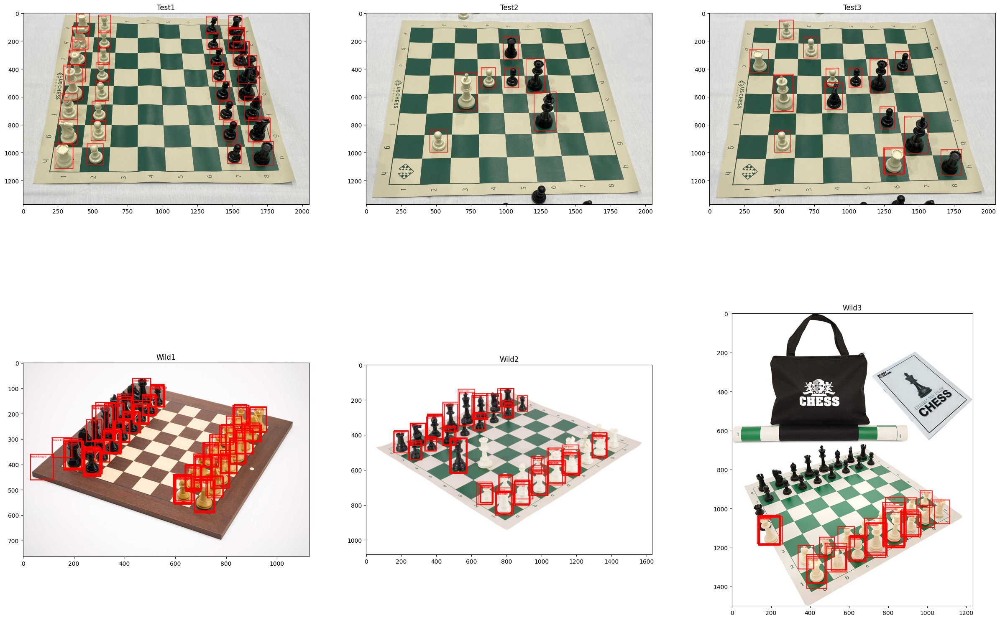

In [ ]:
plt.figure(figsize=[30,20])
for i, img in enumerate(images):
  plt.subplot(2,3,i+1)
  img = read_image(os.path.join(DATASET_ROOT, img))
  batch = [preprocess(img).to(DEVICE)]
  prediction = model(batch)[0]
  # Rysowanie predykcji - wygodny gotowiec
  box = draw_bounding_boxes(
    img,
    boxes=prediction['boxes'],
    labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
    colors='red',
    width=4,
  )
  img = to_pil_image(box.detach()).convert('RGB')
  plt.imshow(img)
  plt.title(labels[i])

#### Change no.4
Zwiększenie score i zmniejszenie nms

In [ ]:
model.roi_heads.score_thresh = 0.30
model.roi_heads.nms_thresh = 0.3

In [ ]:
evaluate(model, val_loader, device=DEVICE)

Test:  [ 0/58]  eta: 0:03:10  model_time: 0.3158 (0.3158)  evaluator_time: 0.0507 (0.0507)  time: 3.2811  data: 2.8854  max mem: 3533
Test:  [57/58]  eta: 0:00:00  model_time: 0.1155 (0.1417)  evaluator_time: 0.0016 (0.0084)  time: 0.1601  data: 0.0176  max mem: 3533
Test: Total time: 0:00:16 (0.2775 s / it)
Averaged stats: model_time: 0.1155 (0.1417)  evaluator_time: 0.0016 (0.0084)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.368
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.443
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.368
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

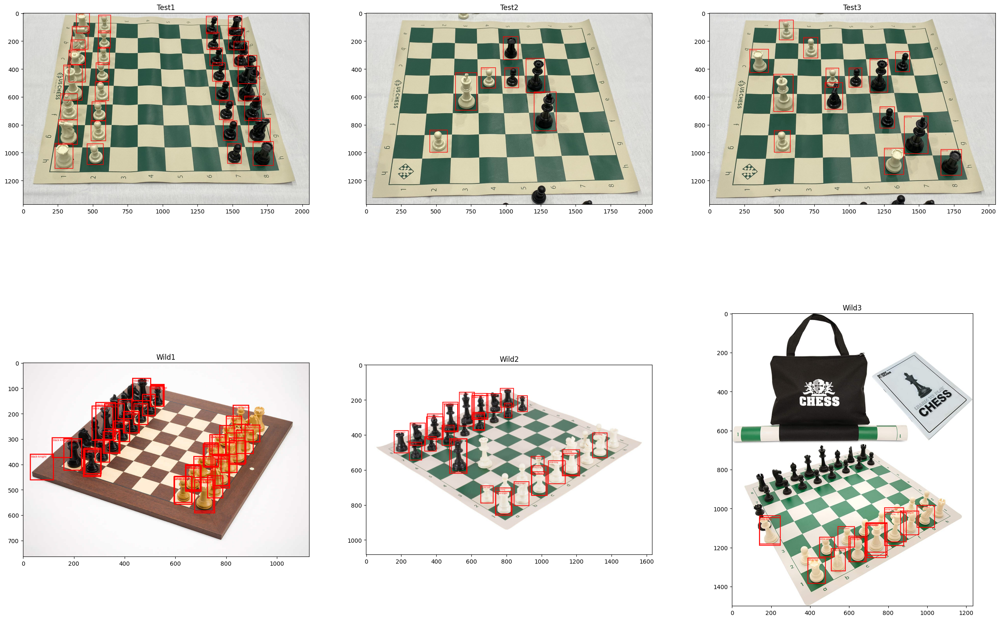

In [ ]:
plt.figure(figsize=[30,20])
for i, img in enumerate(images):
  plt.subplot(2,3,i+1)
  img = read_image(os.path.join(DATASET_ROOT, img))
  batch = [preprocess(img).to(DEVICE)]
  prediction = model(batch)[0]
  # Rysowanie predykcji - wygodny gotowiec
  box = draw_bounding_boxes(
    img,
    boxes=prediction['boxes'],
    labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
    colors='red',
    width=4,
  )
  img = to_pil_image(box.detach()).convert('RGB')
  plt.imshow(img)
  plt.title(labels[i])

### Zadanie 2a

Zwizualizuj propozycje rejonów wygenerowane przez RPN i porównaj z ostateczną predykcją.

W tym celu konieczne będzie manualne wykonanie fragmentu metody `GeneralizedRCNN::forward` (patrz: [kod](https://github.com/pytorch/vision/blob/6279faa88a3fe7de49bf58284d31e3941b768522/torchvision/models/detection/generalized_rcnn.py#L46), link do wersji najnowszej na grudzień 2024).
Wszystkie fragmenty związane z uczeniem możesz rzecz jasna pominąć; chodzi o wyciągnięcie obiektu `proposals`.
Nie zapomnij o wykonaniu powrotnej transformacji! (Po co?)

In [ ]:
model

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [ ]:
model.roi_heads.score_thresh = 0.05
model.roi_heads.nms_thresh = 0.5

In [ ]:

model.eval()
with torch.no_grad():

    imgs = [read_image(os.path.join(DATASET_ROOT, i)) for i in images]
    batch = [preprocess(img).to(DEVICE) for img in imgs]
    original_image_sizes =  [img.shape[-2:] for img in batch]

    transformed_inputs = model.transform(batch)[0]
    transformed_image_sizes = transformed_inputs.image_sizes

    features = model.backbone(transformed_inputs.tensors)

    proposals, _ = model.rpn(transformed_inputs, features, transformed_image_sizes)
    proposals_dicts = [{"boxes": p} for p in proposals]

    proposals_original = model.transform.postprocess(proposals_dicts, transformed_image_sizes, original_image_sizes)

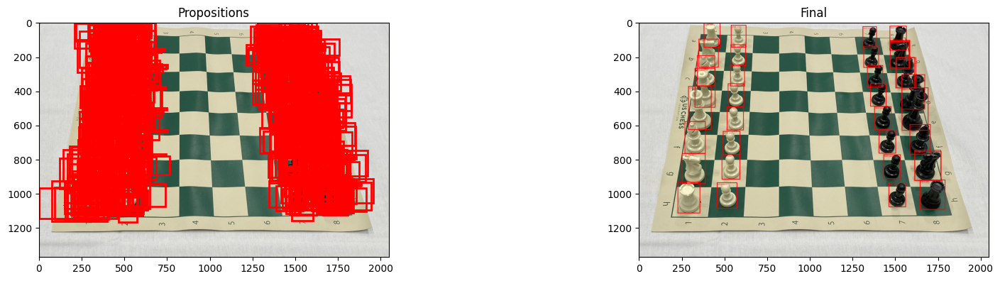

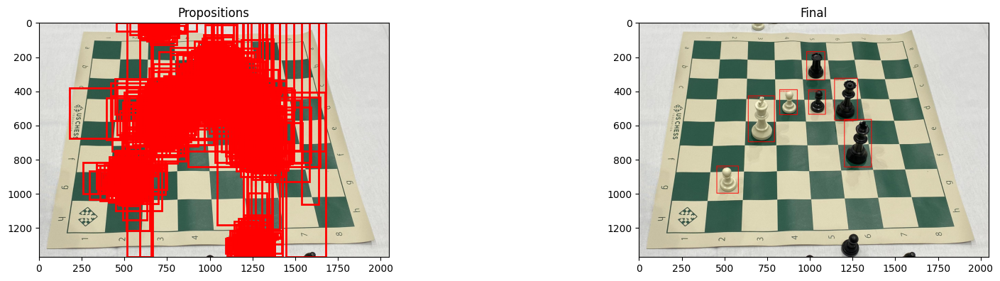

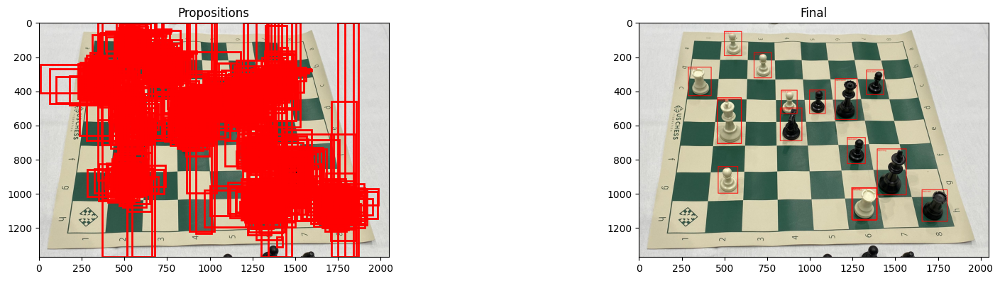

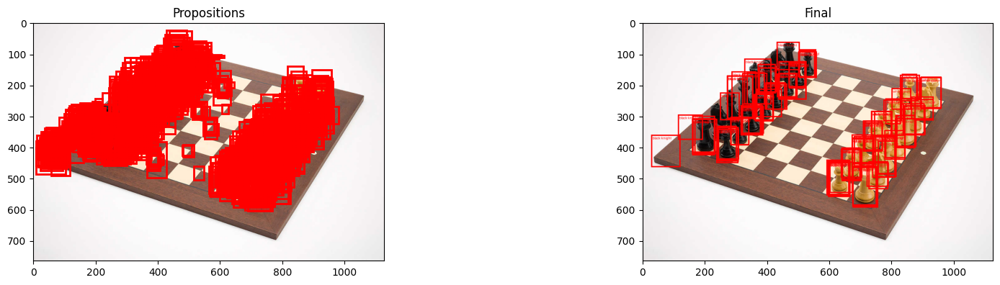

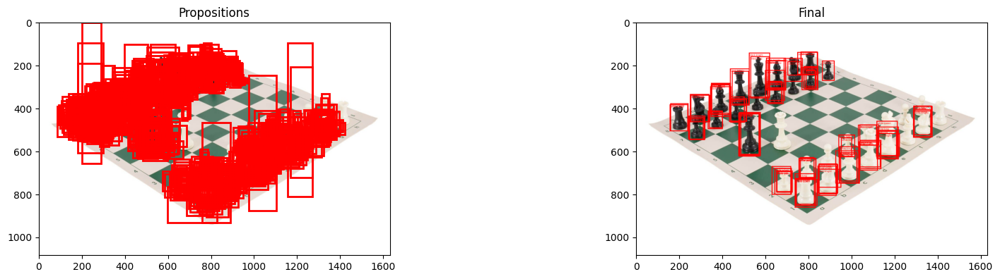

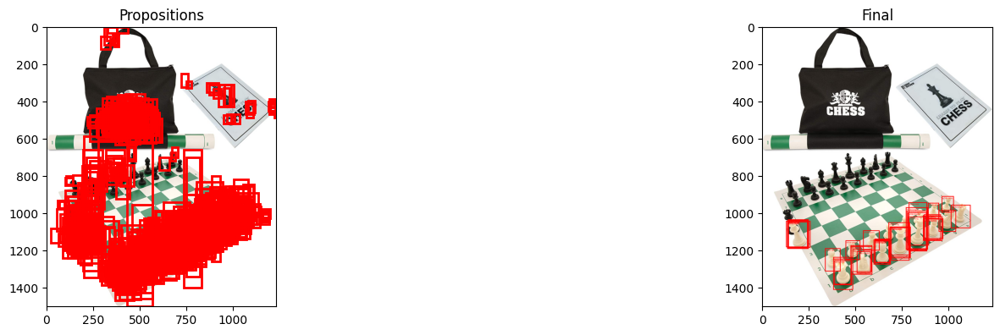

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F


for img, im_path, proposal in zip(imgs, images, proposals_original):
    plt.figure(figsize=[20,30])
    img_np = F.to_pil_image(img.cpu()).convert("RGB")
    plt.subplot(6,2,2*i+1)
    plt.imshow(img_np)

    # Narysuj propozycje
    for box in proposal["boxes"].cpu().numpy():
        xmin, ymin, xmax, ymax = box
        rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, color="red", linewidth=2)
        plt.gca().add_patch(rect)
        plt.title('Propositions')

    img = read_image(os.path.join(DATASET_ROOT, im_path))
    batch = [preprocess(img).to(DEVICE)]
    prediction = model(batch)[0]
    # Rysowanie predykcji - wygodny gotowiec
    box = draw_bounding_boxes(
      img,
      boxes=prediction['boxes'],
      labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
      colors='red',
      width=4,
    )
    img = to_pil_image(box.detach()).convert('RGB')
    plt.subplot(6,2,2*i+2)
    plt.imshow(img)
    plt.title("Final")
    plt.show()


### Zadanie 2b

Zbadaj wpływ progu NMS _na etapie propozycji_ na jakość predykcji oraz czas ich uzyskania.
Jak w poprzednich zadaniach, postaraj się nie ograniczyć tylko do pokazania metryk, ale pokaż wizualizacje (propozycji i predykcji) dla **wybranych** przykładów.

In [ ]:
model.rpn.nms_thresh

0.7

In [ ]:
evaluate(model, val_loader, device=DEVICE)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Test:  [ 0/58]  eta: 0:02:30  model_time: 0.1866 (0.1866)  evaluator_time: 0.0226 (0.0226)  time: 2.5933  data: 2.3491  max mem: 5063
Test:  [57/58]  eta: 0:00:00  model_time: 0.1019 (0.1398)  evaluator_time: 0.0013 (0.0112)  time: 0.1822  data: 0.0341  max mem: 5063
Test: Total time: 0:00:16 (0.2885 s / it)
Averaged stats: model_time: 0.1019 (0.1398)  evaluator_time: 0.0013 (0.0112)
Accumulating evaluation results...
DONE (t=0.07s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.156
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.222
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.184
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.156
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

In [ ]:
model.rpn.nms_thresh = 0.2
evaluate(model, val_loader, device=DEVICE)

Test:  [ 0/58]  eta: 0:03:39  model_time: 0.2921 (0.2921)  evaluator_time: 0.0431 (0.0431)  time: 3.7828  data: 3.4183  max mem: 5063
Test:  [57/58]  eta: 0:00:00  model_time: 0.1004 (0.1350)  evaluator_time: 0.0016 (0.0107)  time: 0.1528  data: 0.0223  max mem: 5063
Test: Total time: 0:00:17 (0.2965 s / it)
Averaged stats: model_time: 0.1004 (0.1350)  evaluator_time: 0.0016 (0.0107)
Accumulating evaluation results...
DONE (t=0.22s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.214
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.287
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.260
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.214
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

In [ ]:
model.rpn.nms_thresh = 0.5
evaluate(model, val_loader, device=DEVICE)

Test:  [ 0/58]  eta: 0:02:29  model_time: 0.2205 (0.2205)  evaluator_time: 0.0072 (0.0072)  time: 2.5784  data: 2.3101  max mem: 5063
Test:  [57/58]  eta: 0:00:00  model_time: 0.1028 (0.1316)  evaluator_time: 0.0010 (0.0100)  time: 0.1436  data: 0.0157  max mem: 5063
Test: Total time: 0:00:15 (0.2722 s / it)
Averaged stats: model_time: 0.1028 (0.1316)  evaluator_time: 0.0010 (0.0100)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.258
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.343
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.309
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.258
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

In [ ]:
model.rpn.nms_thresh = 0.9
evaluate(model, val_loader, device=DEVICE)

Test:  [ 0/58]  eta: 0:03:49  model_time: 0.2908 (0.2908)  evaluator_time: 0.0288 (0.0288)  time: 3.9564  data: 3.5711  max mem: 5063
Test:  [57/58]  eta: 0:00:00  model_time: 0.1038 (0.1321)  evaluator_time: 0.0015 (0.0084)  time: 0.1418  data: 0.0154  max mem: 5063
Test: Total time: 0:00:16 (0.2839 s / it)
Averaged stats: model_time: 0.1038 (0.1321)  evaluator_time: 0.0015 (0.0084)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.206
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.282
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.242
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDe

#### Wizualizacja

In [ ]:
model.rpn.nms_thresh = 0.5

In [ ]:
model.eval()
with torch.no_grad():

    imgs = [read_image(os.path.join(DATASET_ROOT, i)) for i in images]
    batch = [preprocess(img).to(DEVICE) for img in imgs]
    original_image_sizes =  [img.shape[-2:] for img in batch]

    transformed_inputs = model.transform(batch)[0]
    transformed_image_sizes = transformed_inputs.image_sizes

    features = model.backbone(transformed_inputs.tensors)

    proposals, _ = model.rpn(transformed_inputs, features, transformed_image_sizes)
    proposals_dicts = [{"boxes": p} for p in proposals]

    proposals_original = model.transform.postprocess(proposals_dicts, transformed_image_sizes, original_image_sizes)

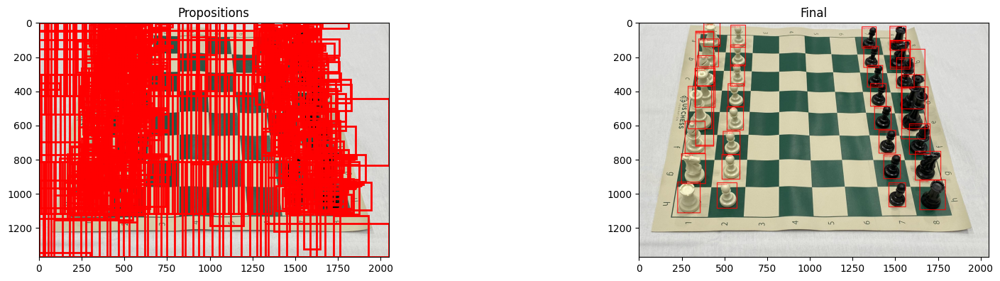

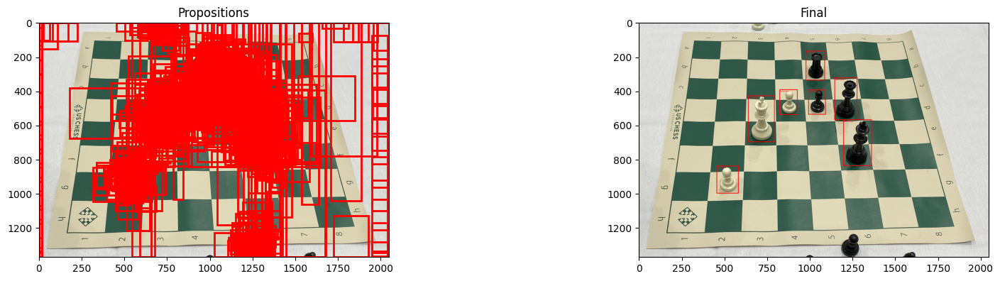

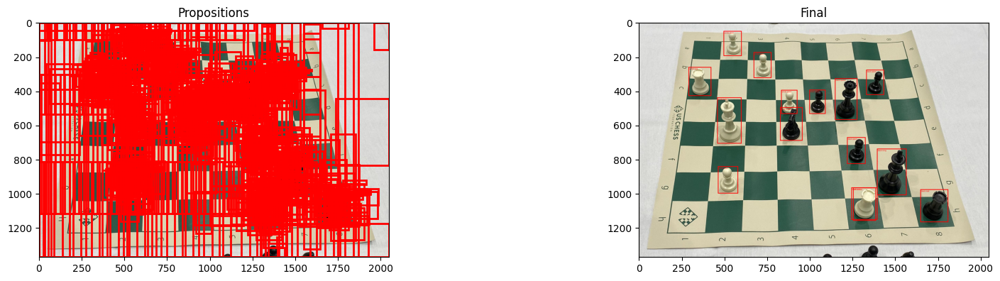

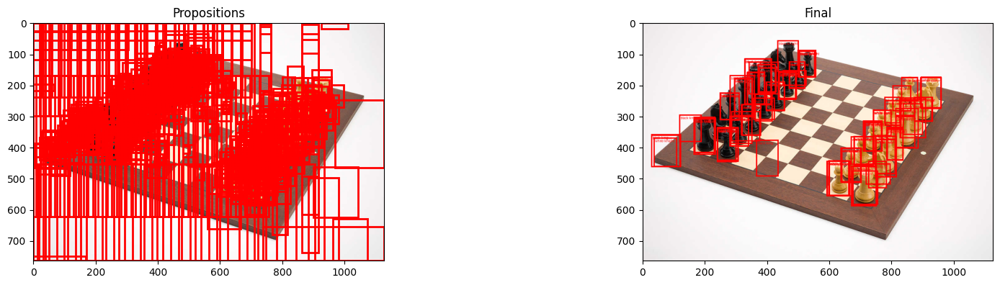

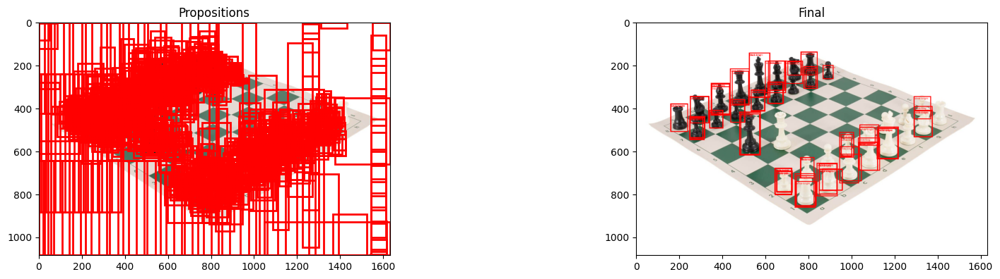

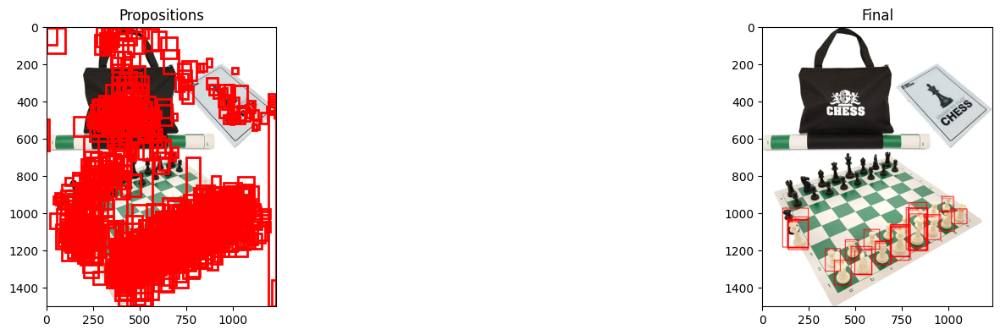

In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F


for img, im_path, proposal in zip(imgs, images, proposals_original):
    plt.figure(figsize=[20,30])
    img_np = F.to_pil_image(img.cpu()).convert("RGB")
    plt.subplot(6,2,2*i+1)
    plt.imshow(img_np)

    # Narysuj propozycje
    for box in proposal["boxes"].cpu().numpy():
        xmin, ymin, xmax, ymax = box
        rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, color="red", linewidth=2)
        plt.gca().add_patch(rect)
        plt.title('Propositions')

    img = read_image(os.path.join(DATASET_ROOT, im_path))
    batch = [preprocess(img).to(DEVICE)]
    prediction = model(batch)[0]
    # Rysowanie predykcji - wygodny gotowiec
    box = draw_bounding_boxes(
      img,
      boxes=prediction['boxes'],
      labels=[chess_train.coco.cats[i.item()]['name'] for i in prediction['labels']],
      colors='red',
      width=4,
    )
    img = to_pil_image(box.detach()).convert('RGB')
    plt.subplot(6,2,2*i+2)
    plt.imshow(img)
    plt.title("Final")
    plt.show()
